In [2]:
import json
import os
import datetime
import zipfile
import re
from Images_of_given_index import image_true_color
from IPython.display import Audio, display
from timeit import default_timer as timer
import glob
start = timer()
def alert():
  global start
  end= timer()
  print("\n\nDuration in minutes : " +  str((end - start)/60) + " minutes." )
  display(Audio(url='https://sound.peal.io/ps/audios/000/000/537/original/woo_vu_luvub_dub_dub.wav', autoplay=True))

In [3]:
with open("./data/discharges_in_water_data.json") as f:
  data = json.load(f)
i=0
for row in data :
    row["index"] = i
    i+=1
data

[{'type': 'descarga ilegal',
  'description': 'Descarga suinÃ\xadcola ilegal',
  'local': 'Leiria',
  'date': '29/08/2019',
  'time': '',
  'lat': '39.751',
  'lon': '-8.813',
  'url': 'https://www.cmjornal.pt/portugal/detalhe/gnr-identifica-autor-de-descarga-suinicola-ilegal-em-leiria',
  'index': 0},
 {'type': 'descarga ilegal',
  'description': 'Descarga poluente por um barco',
  'local': 'Rio Douro em Vila Nova de Foz CÃ´a',
  'date': '25/06/2019',
  'time': '',
  'lat': '41.108',
  'lon': '-7.095',
  'url': 'https://www.cmjornal.pt/portugal/cidades/detalhe/investigada-descarga-poluente-no-rio-douro-em-vila-nova-de-foz-coa',
  'index': 1},
 {'type': 'descarga ilegal',
  'description': 'Descarga ilegal por avaria na ETAR',
  'local': 'Rio tinto',
  'date': '29/08/2019',
  'time': '',
  'lat': '41.177',
  'lon': '-8.561',
  'url': 'http://portocanal.sapo.pt/noticia/194608',
  'index': 2},
 {'type': 'descarga ilegal',
  'description': 'Descarga ilegal de matÃ©rias poluentes',
  'local

In [4]:
def find_images(coords,sensing_date_FROM,sensing_date_TO,filename, sentinel=2) :
    global USERNAME
    global PASSWORD
    command = "dhusget.sh -u "+USERNAME+" -p "+PASSWORD +" -S "+sensing_date_FROM+" -E "+sensing_date_TO +" -c "+coords
    if sentinel !=0 :
        command = command + " -m Sentinel-"+ str(sentinel)
    command = command + " -q " + filename +  ".xml -C " + filename + ".csv"
    os.system(command)

In [5]:
def date_to_iso_format (date,time,before=True):
    date = str(date)
    if (date=="nan") :
        return "nan"
    splited = date.split('/')
    dt = datetime.datetime(int(splited[2]), int(splited[1]),  int(splited[0]))
    iso = str(dt.year) + "-" + str(dt.month) + "-" + str(dt.day)
    newtime = "T" + time + ".000Z"
    iso = iso +  newtime
    return iso

date_to_iso_format("07/08/2015", "06:44:00")

'2015-8-7T06:44:00.000Z'

In [6]:
USERNAME = ''
PASSWORD = ''
lon1="-4"
lat1="30"
lon2="26"
lat2="46"
coords = lon1 + "," + lat1 + ":" + lon2 + "," + lat2 
sensing_date_FROM = "2015-01-01T06:00:00.000Z"
sensing_date_TO = "2016-01-01T06:00:00.000Z"
filename = "./images_with_fires_results/test"
#find_images(coords,sensing_date_FROM,sensing_date_TO,filename)

# Find Images

In [29]:
for row in data:
    lat =row["lat"]
    lon =row["lon"]
    lon1=str( float(lon)-0.1 )
    lat1=str( float(lat)-0.1 )
    lon2=str( float(lon)+0.1 )
    lat2= str( float(lat)+0.1 )
    coords = lon1 + "," + lat1 + ":" + lon2 + "," + lat2 
    sensing_date_FROM = date_to_iso_format(row["date"] , "05:00:00" )
    sensing_date_TO = date_to_iso_format(row["date"] , "20:00:00" ,False)
    filename = "./images_with_discharges_results/index"+str( row["index"] )
    print(coords,sensing_date_FROM,sensing_date_TO,filename)
    print("\n")
    find_images(coords,sensing_date_FROM,sensing_date_TO,filename,sentinel=2)
    

-8.913,39.650999999999996:-8.713000000000001,39.851 2019-8-29T05:00:00.000Z 2019-8-29T20:00:00.000Z ./images_with_discharges_results/index0


-7.194999999999999,41.007999999999996:-6.995,41.208 2019-6-25T05:00:00.000Z 2019-6-25T20:00:00.000Z ./images_with_discharges_results/index1


-8.661,41.077:-8.461,41.277 2019-8-29T05:00:00.000Z 2019-8-29T20:00:00.000Z ./images_with_discharges_results/index2


-8.53,41.439:-8.33,41.639 2019-2-19T05:00:00.000Z 2019-2-19T20:00:00.000Z ./images_with_discharges_results/index3


-9.075,38.922:-8.875,39.122 2019-10-2T05:00:00.000Z 2019-10-2T20:00:00.000Z ./images_with_discharges_results/index4


-8.3119,41.324999999999996:-8.1119,41.525 2017-5-10T05:00:00.000Z 2017-5-10T20:00:00.000Z ./images_with_discharges_results/index5


-8.53,41.439:-8.33,41.639 2019-1-9T05:00:00.000Z 2019-1-9T20:00:00.000Z ./images_with_discharges_results/index6


-8.875817999999999,41.301034:-8.675818,41.501034000000004 2018-5-3T05:00:00.000Z 2018-5-3T20:00:00.000Z ./images_with_

# Download images

In [32]:
files = glob.glob("./images_with_discharges_results/*.csv")

for file in files : 
    global USERNAME, PASSWORD
    if (os.path.getsize(file) >0 ) :
        downloads = pd.read_csv(file, sep=',' , encoding="utf-8",na_values="nan",header=None)
        splited = file.split('\\')
        id_fire = splited[len(splited)-1][:-4]
        for index, row in downloads.iterrows():
            outputpath = "../../Satellite_img_discharges/" + id_fire
            if (not os.path.isdir(outputpath)):
                os.mkdir(outputpath)
            outputpath = outputpath + '/' + row[0] + '.zip'
            command = "wget --continue --user="+USERNAME+" --password="+PASSWORD+" \""+ row[1] + "/$value" +"\" -O " + outputpath
            print(outputpath,"\n\n")
            os.system(command)

../../Satellite_img_discharges/index18/S2A_MSIL2A_20181115T120211_N0210_R023_T28SCB_20181115T123341.zip 


../../Satellite_img_discharges/index18/S2A_MSIL2A_20181115T120211_N0210_R023_T28SBB_20181115T123341.zip 


../../Satellite_img_discharges/index18/S2A_MSIL1C_20181115T120211_N0207_R023_T28SCB_20181115T121418.zip 


../../Satellite_img_discharges/index18/S2A_MSIL1C_20181115T120211_N0207_R023_T28SBB_20181115T121418.zip 


../../Satellite_img_discharges/index3/S2B_MSIL2A_20190219T112119_N0211_R037_T29TNG_20190219T155447.zip 


../../Satellite_img_discharges/index3/S2B_MSIL2A_20190219T112119_N0211_R037_T29TNF_20190219T155447.zip 


../../Satellite_img_discharges/index3/S2B_MSIL1C_20190219T112119_N0207_R037_T29TNF_20190219T150459.zip 


../../Satellite_img_discharges/index3/S2B_MSIL1C_20190219T112119_N0207_R037_T29TNG_20190219T150459.zip 


../../Satellite_img_discharges/index4/S2A_MSIL2A_20191002T112121_N0213_R037_T29SMD_20191002T122046.zip 


../../Satellite_img_discharges/index4/S2A_

# Unnzipping and setting up downloaded images

In [33]:
indexs = os.listdir("../../Satellite_img_discharges/") 
print ( indexs)  # indexes of fires of images founded
for index in indexs :
    index_id = index[5:]
    path = "../../Satellite_img_discharges/index"+ index_id
    images_ids = os.listdir(path) # images founded for index choosen
    for file in images_ids : 
        print(file)
        path_with_img_id = path + "/" + file
        if ( zipfile.is_zipfile(path_with_img_id) and os.stat(path_with_img_id).st_size >0  ) :
            with zipfile.ZipFile(path_with_img_id,"r") as zip_ref:
                path_output = path + "/" + file [ 37 :  ]
                cut = len(path_output)-4
                path_output = path_output [ : cut ]
                print(path_output)
                names = zip_ref.namelist()
                regexp = re.compile(r'.*SAFE/GRANULE/.*/IMG_DATA/.*B0[2348]')
                img_data = []
                for f in names :
                    if  regexp.search(f) :
                        img_data.append(f)
                print(len(img_data))
                zip_ref.extractall(  members =  img_data , path = path_output )
        os.remove(path_with_img_id)

['index18', 'index3', 'index4', 'index7', 'index9']
S2A_MSIL1C_20181115T120211_N0207_R023_T28SBB_20181115T121418.zip
../../Satellite_img_discharges/index18/_T28SBB_20181115T121418
4
S2A_MSIL1C_20181115T120211_N0207_R023_T28SCB_20181115T121418.zip
../../Satellite_img_discharges/index18/_T28SCB_20181115T121418
4
S2A_MSIL2A_20181115T120211_N0210_R023_T28SBB_20181115T123341.zip
../../Satellite_img_discharges/index18/_T28SBB_20181115T123341
10
S2A_MSIL2A_20181115T120211_N0210_R023_T28SCB_20181115T123341.zip
../../Satellite_img_discharges/index18/_T28SCB_20181115T123341
10
S2B_MSIL1C_20190219T112119_N0207_R037_T29TNF_20190219T150459.zip
../../Satellite_img_discharges/index3/_T29TNF_20190219T150459
4
S2B_MSIL1C_20190219T112119_N0207_R037_T29TNG_20190219T150459.zip
../../Satellite_img_discharges/index3/_T29TNG_20190219T150459
4
S2B_MSIL2A_20190219T112119_N0211_R037_T29TNF_20190219T155447.zip
../../Satellite_img_discharges/index3/_T29TNF_20190219T155447
10
S2B_MSIL2A_20190219T112119_N0211_R037_

# Visualizing images

In [7]:
indexs = os.listdir("../../Satellite_img_discharges/") 
n_total = 0
for index in indexs :
    index_id = index[5:]
    path = "../../Satellite_img_discharges/index"+ index_id
    images_ids = os.listdir(path) 
    for image_id in images_ids : 
        n_total = n_total + 1
print("Number of Images = ",n_total )

Number of Images =  18




->>>>>>>>>>>>>>>>>> 18    _T28SBB_20181115T121418       Image 1  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


10880 10980 8339 9139


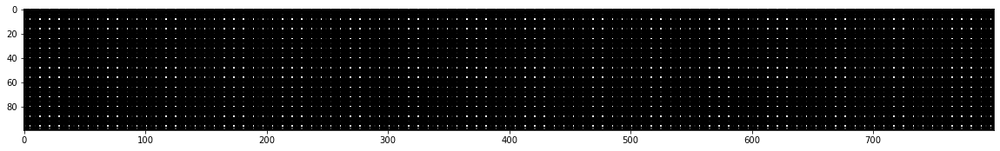



Duration in minutes : 9.211349218333334 minutes.




->>>>>>>>>>>>>>>>>> 18    _T28SBB_20181115T123341       Image 2  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


10880 10980 8339 9139


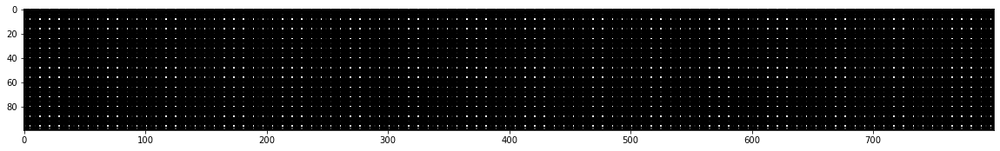



Duration in minutes : 14.052406305 minutes.




->>>>>>>>>>>>>>>>>> 18    _T28SCB_20181115T121418       Image 3  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


1449 2249 8339 9139


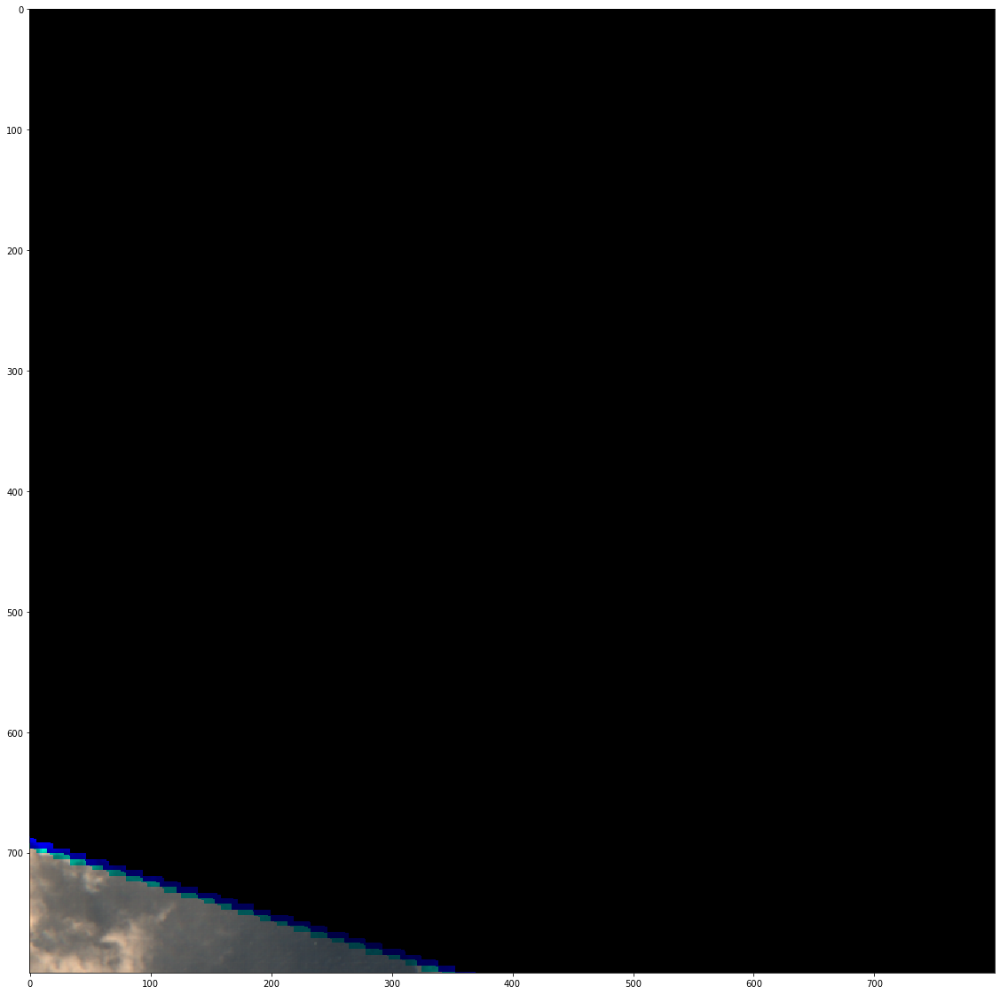



Duration in minutes : 19.016427931666666 minutes.


->>>>>>>>>>>>>>>>>> 18    _T28SCB_20181115T123341       Image 4  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


1449 2249 8339 9139


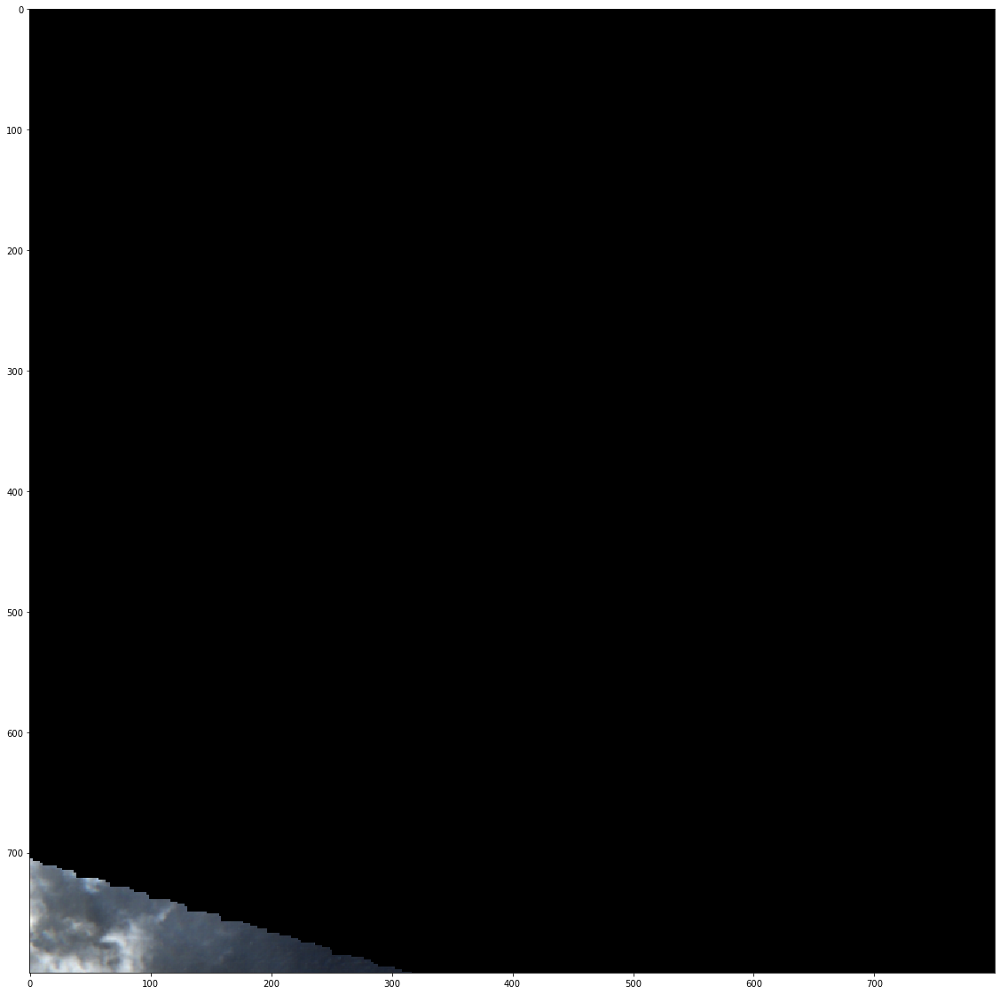



Duration in minutes : 24.287885261666666 minutes.




->>>>>>>>>>>>>>>>>> 3    _T29TNF_20190219T150459       Image 5  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


4356 5156 0 526


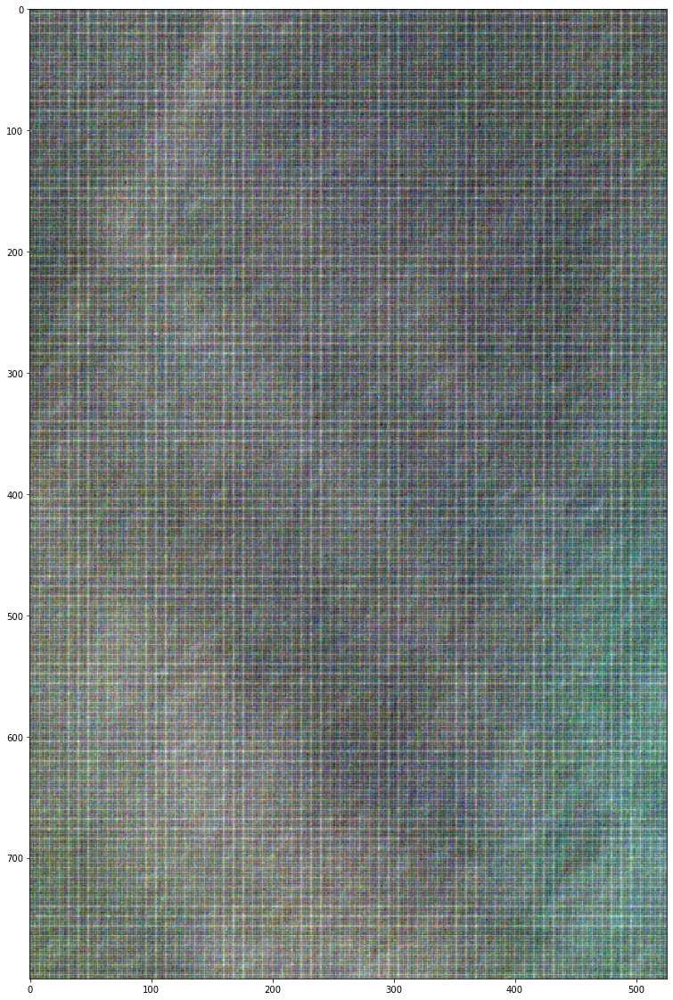



Duration in minutes : 30.31773202 minutes.




->>>>>>>>>>>>>>>>>> 3    _T29TNF_20190219T155447       Image 6  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


4356 5156 0 526


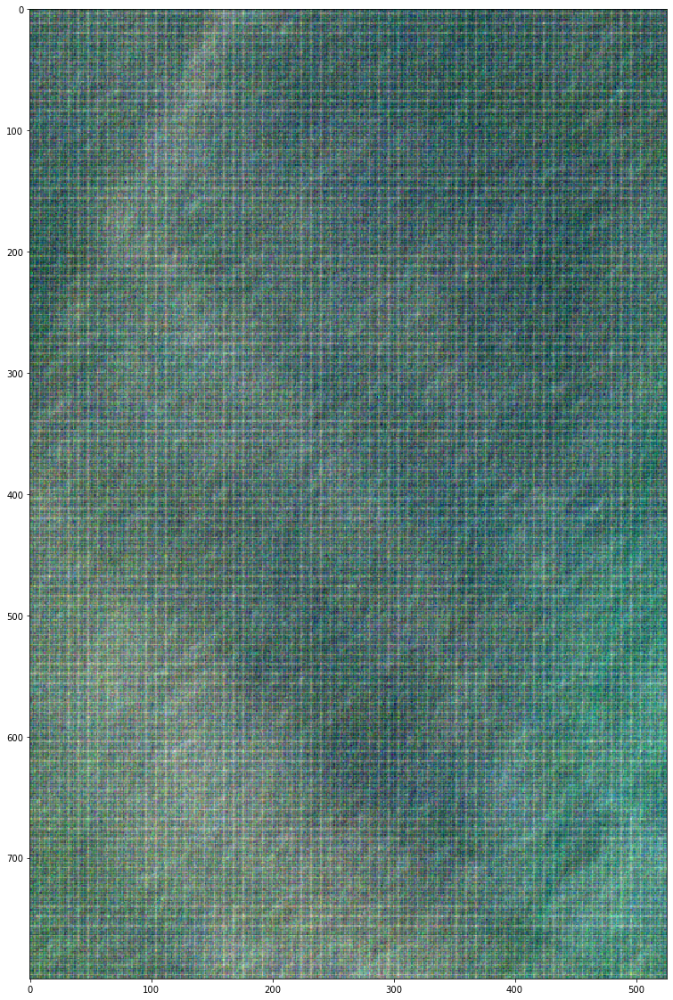



Duration in minutes : 36.447785970000005 minutes.




->>>>>>>>>>>>>>>>>> 3    _T29TNG_20190219T150459       Image 7  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


4356 5156 9728 10528


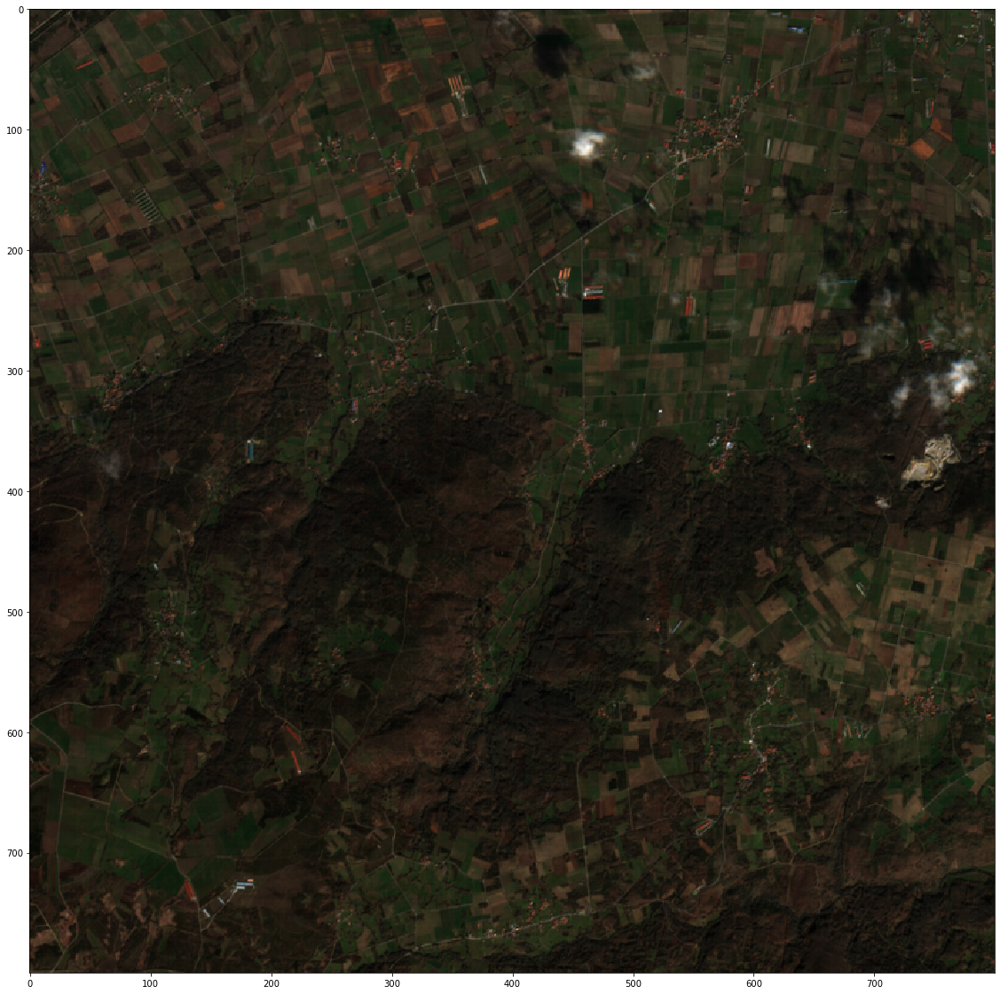



Duration in minutes : 42.63130786 minutes.




->>>>>>>>>>>>>>>>>> 3    _T29TNG_20190219T155447       Image 8  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


4356 5156 9728 10528


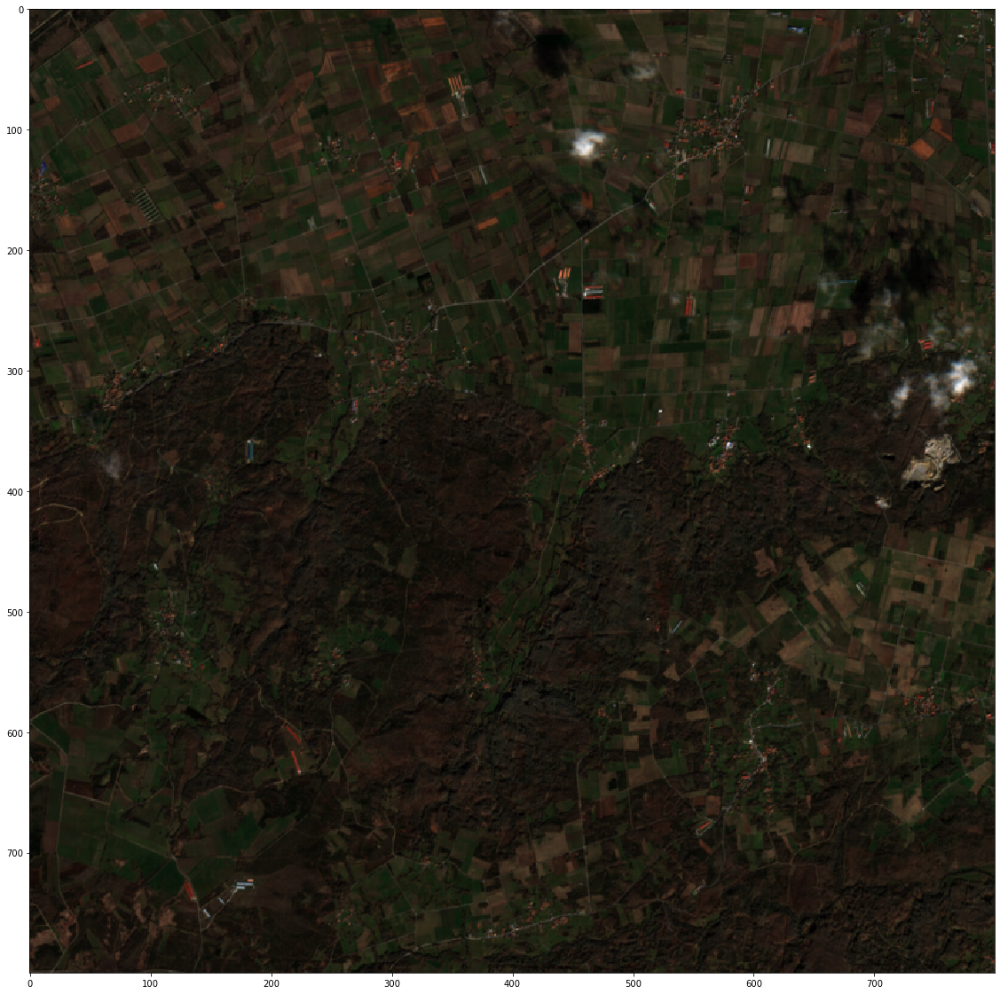



Duration in minutes : 49.056672148333334 minutes.




->>>>>>>>>>>>>>>>>> 4    _T29SMD_20191002T114637       Image 9  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


9820 10620 7682 8482


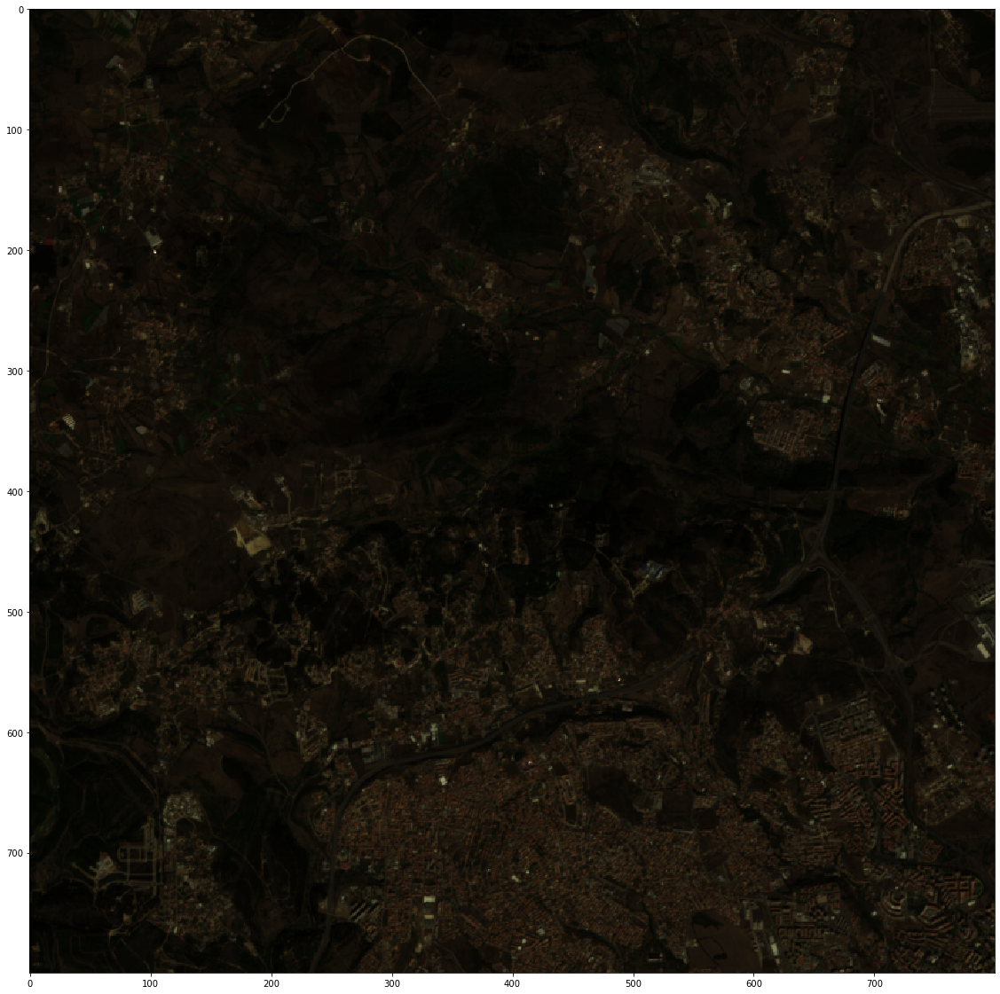



Duration in minutes : 53.838595455000004 minutes.




->>>>>>>>>>>>>>>>>> 4    _T29SMD_20191002T122046       Image 10  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


9820 10620 7682 8482


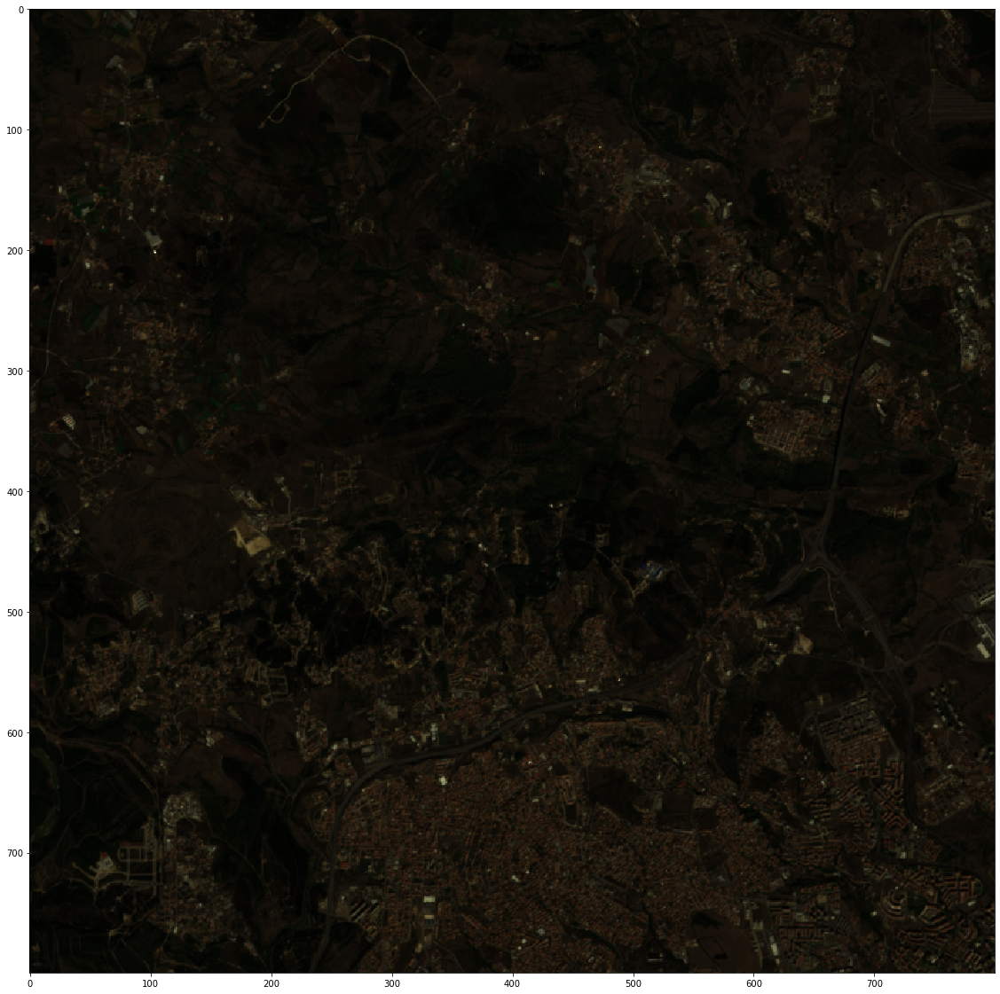



Duration in minutes : 58.85387516666666 minutes.




->>>>>>>>>>>>>>>>>> 4    _T29SND_20191002T114637       Image 11  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


0 618 7682 8482


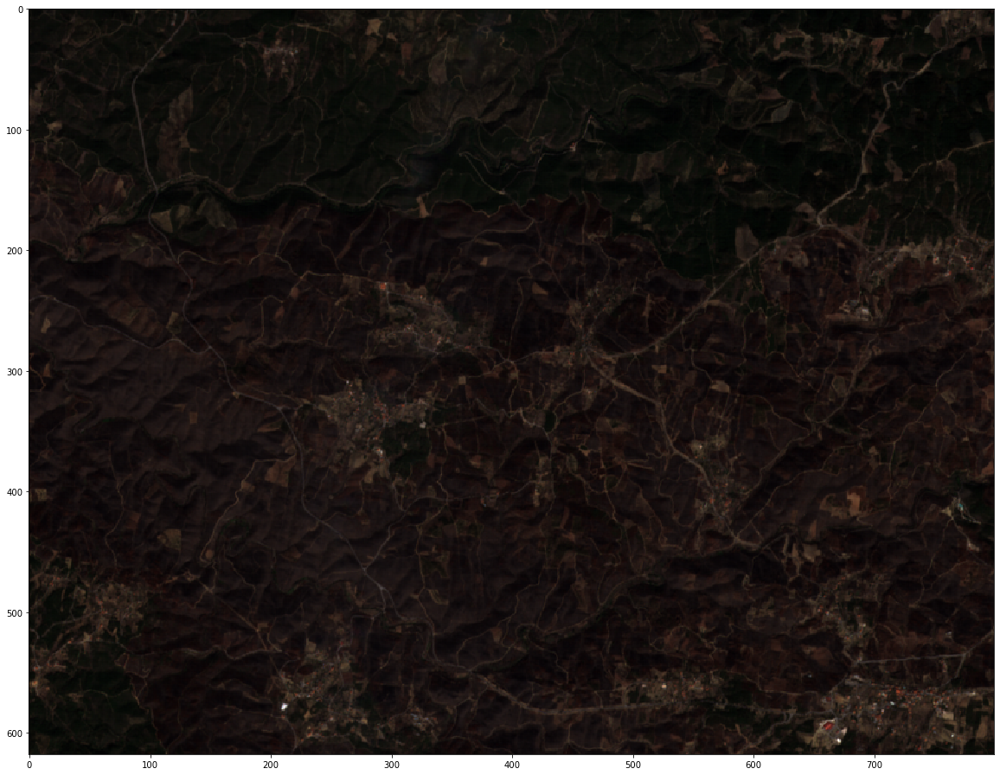



Duration in minutes : 65.341387795 minutes.




->>>>>>>>>>>>>>>>>> 4    _T29SND_20191002T122046       Image 12  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


0 618 7682 8482


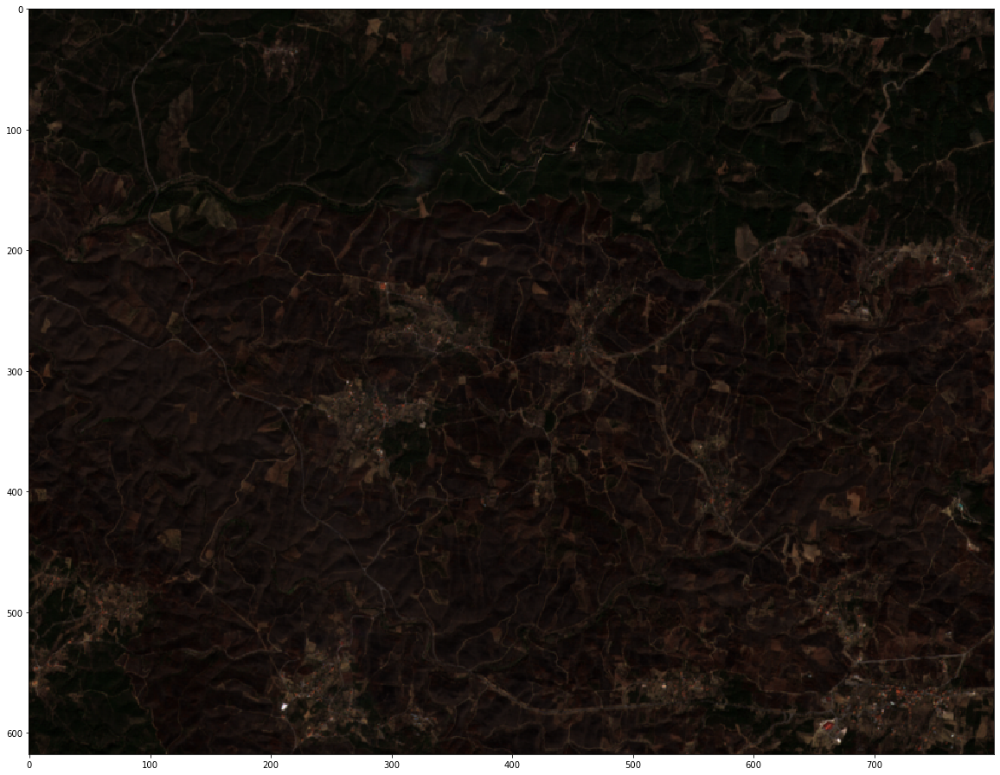



Duration in minutes : 72.04011669333333 minutes.




->>>>>>>>>>>>>>>>>> 7    _T29TNF_20180503T151930       Image 13  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


1475 2275 1271 2071


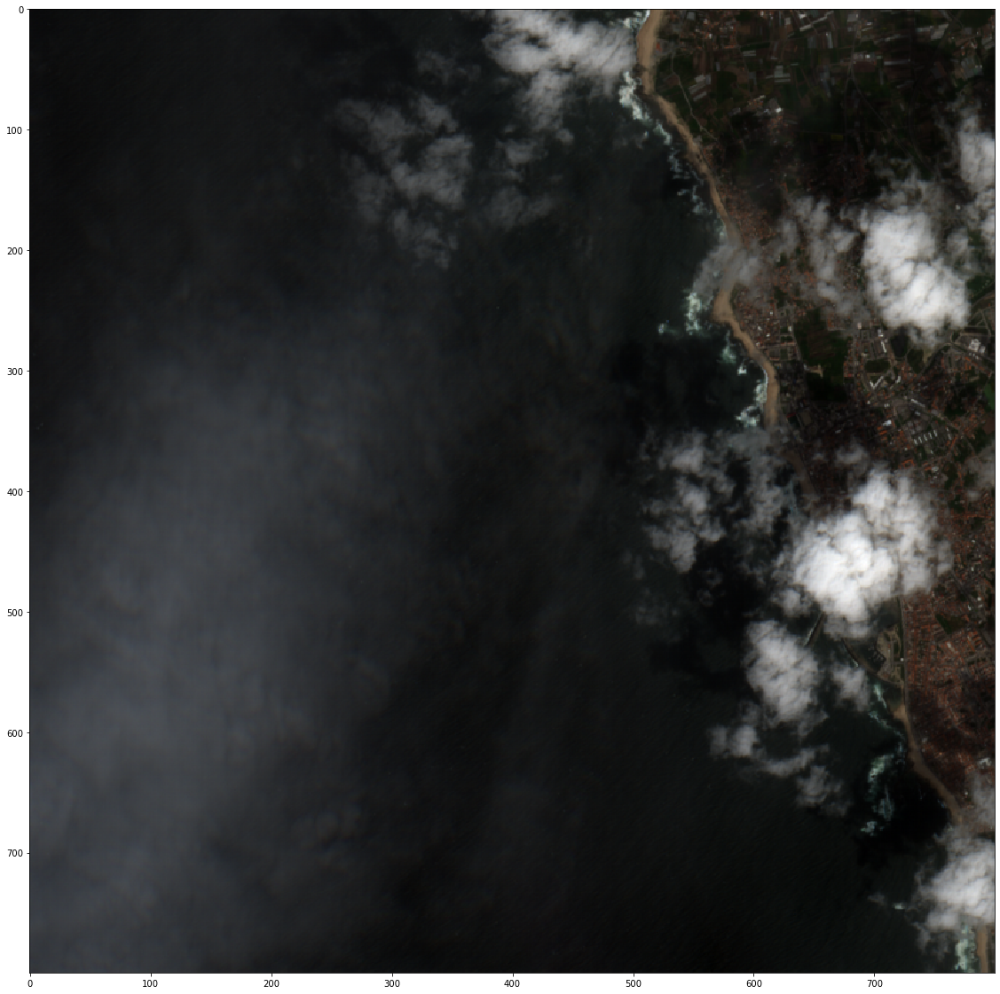



Duration in minutes : 76.457640815 minutes.




->>>>>>>>>>>>>>>>>> 7    _T29TNG_20180503T151930       Image 14  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


1475 2275 10880 10980


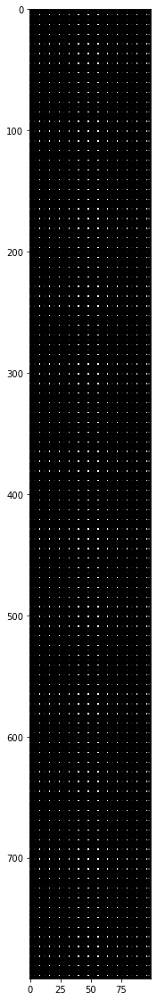



Duration in minutes : 82.14993763333332 minutes.




->>>>>>>>>>>>>>>>>> 9    _T29SMD_20190515T132120       Image 15  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


10005 10805 3994 4794


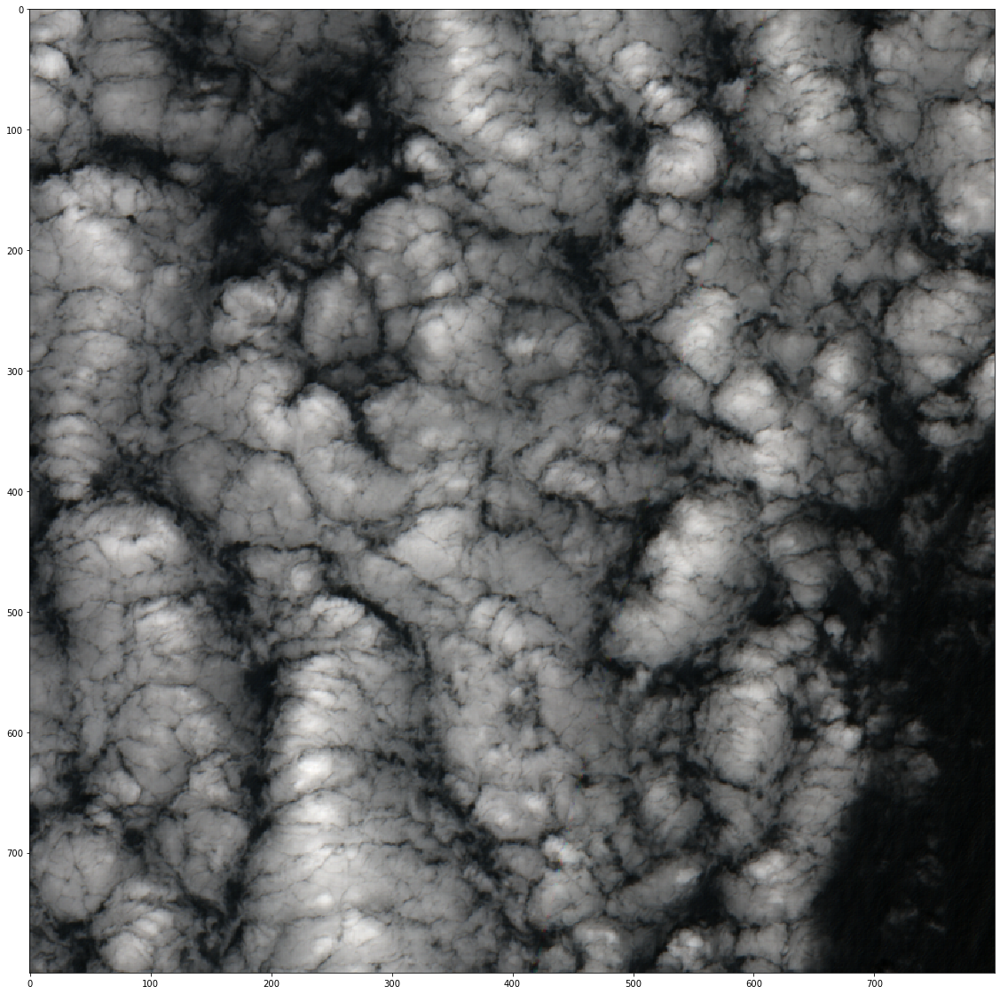



Duration in minutes : 87.25662539499999 minutes.




->>>>>>>>>>>>>>>>>> 9    _T29SMD_20190515T140354       Image 16  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


10005 10805 3994 4794


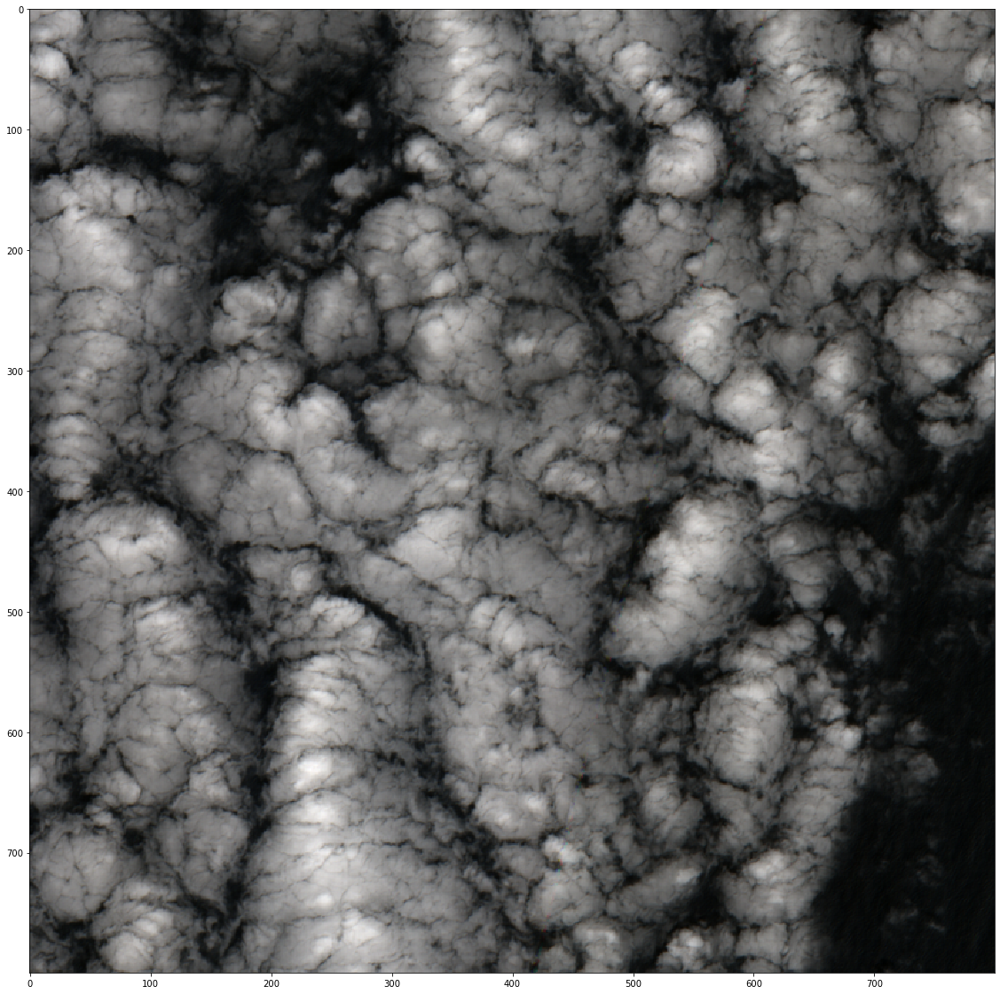



Duration in minutes : 92.20407755833334 minutes.




->>>>>>>>>>>>>>>>>> 9    _T29SND_20190515T132120       Image 17  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


3 803 3994 4794


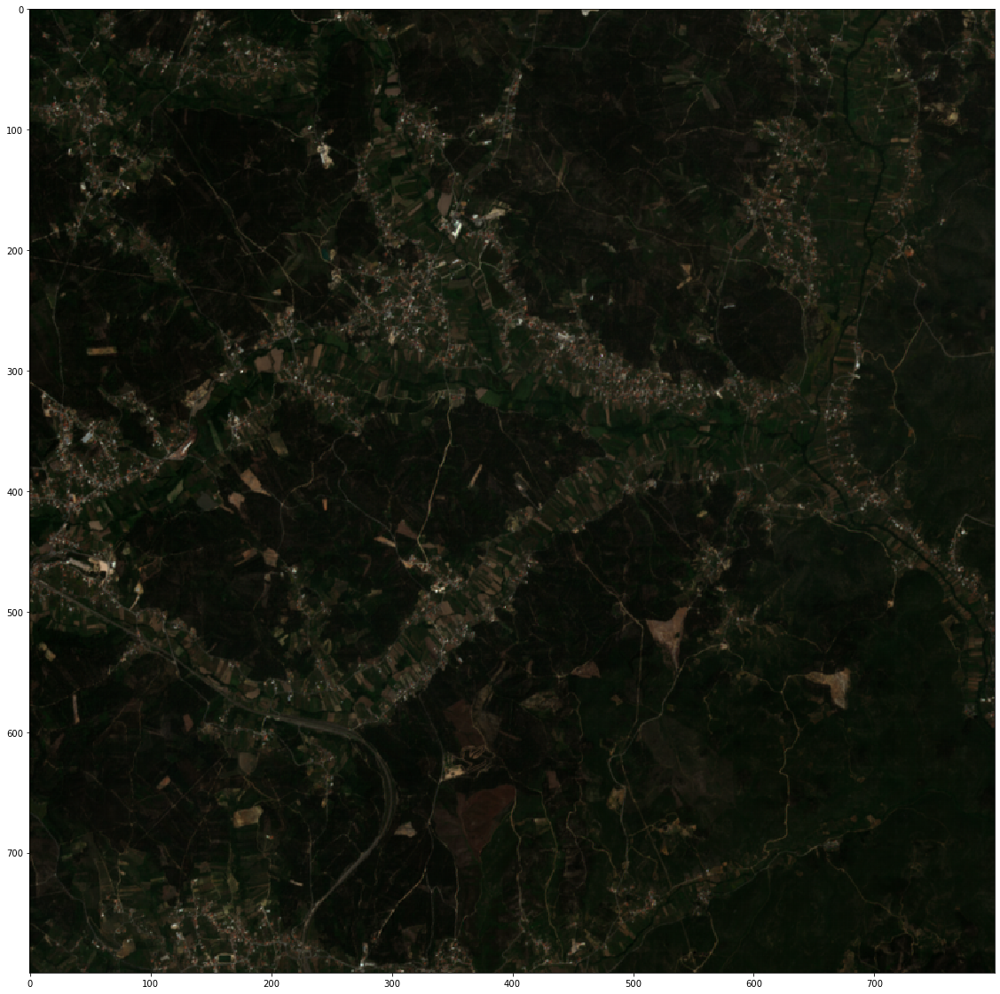



Duration in minutes : 98.355610215 minutes.




->>>>>>>>>>>>>>>>>> 9    _T29SND_20190515T140354       Image 18  of  18   

 


C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
C:\ProgramData\Anaconda3\envs\geo_py37\lib\site-packages\pyproj\crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


3 803 3994 4794


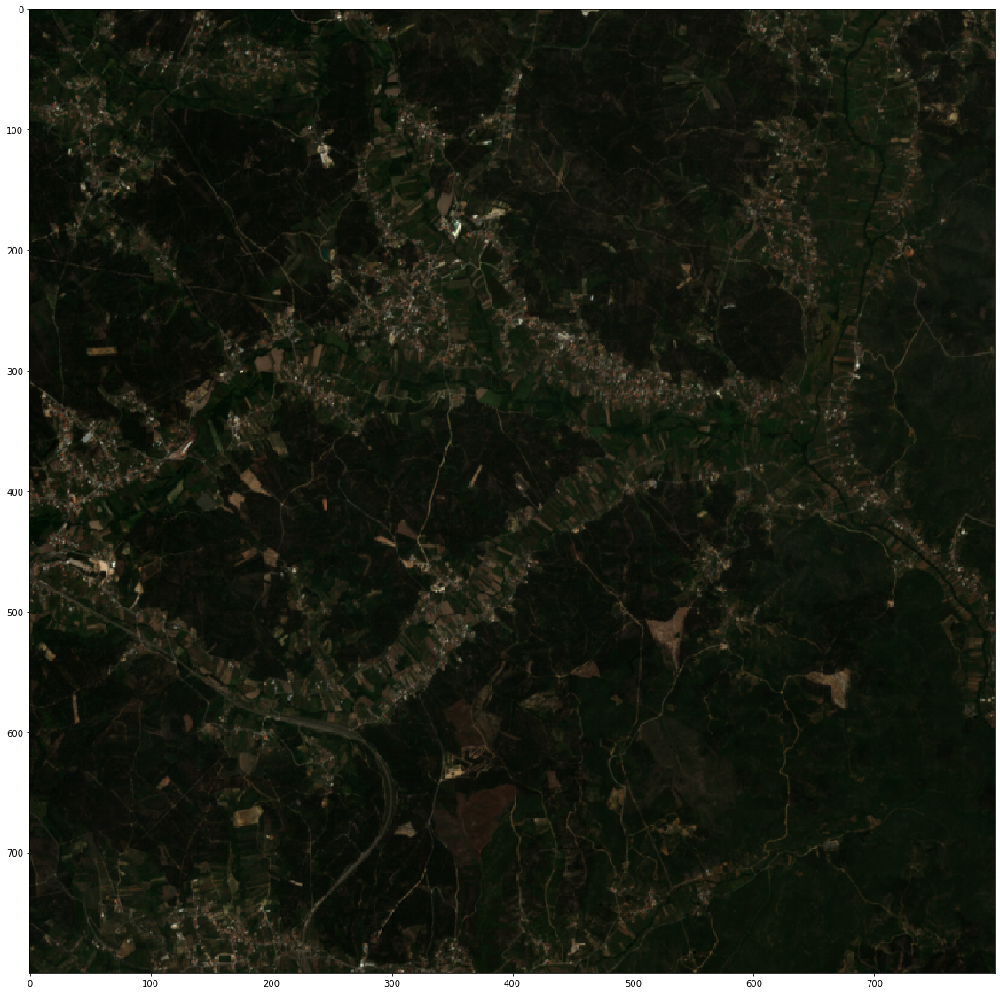



Duration in minutes : 104.83413980666666 minutes.


In [11]:
indexs = os.listdir("../../Satellite_img_discharges/")
n=0
for index in indexs :
    index_id = index[5:]
    path = "../../Satellite_img_discharges/index"+ index_id
    images_ids = os.listdir(path) # images founded for index choosen
    for image_id in images_ids :
        n= n + 1 
        print("\n\n->>>>>>>>>>>>>>>>>>", index_id,"  " ,image_id, "      Image", n ," of " , n_total ,"  \n\n " )
        
        images_path  = "../../Satellite_img_discharges/"
        
        path = images_path + 'index' + index_id + '/' + image_id

        for name_safe in os.listdir(path) :
            if  image_id in name_safe :
                safe = name_safe

        path = path + '/' + safe + '/GRANULE/'
        semifolder = os.listdir(path)[0]
        path = path + '/' + semifolder + '/IMG_DATA/'
        
        if len(os.listdir(path)) > 3 :
            DifRes = False
        else :
            DifRes = True
        image_true_color(index_id,image_id ,images_path,data[int(index_id)]["lon"] ,data[int(index_id)]["lat"],DifRes)

        alert()

In [ ]:
alert()